<a href="https://colab.research.google.com/github/NatashaKamami/Python-Data-Analysis/blob/main/Heart_data.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import missingno as msno


#**Loading the data**

In [ ]:
data = pd.read_csv('/content/heart_2022_with_nans.csv')
print(data.head())

     State     Sex GeneralHealth  PhysicalHealthDays  MentalHealthDays  \
0  Alabama  Female     Very good                 0.0               0.0   
1  Alabama  Female     Excellent                 0.0               0.0   
2  Alabama  Female     Very good                 2.0               3.0   
3  Alabama  Female     Excellent                 0.0               0.0   
4  Alabama  Female          Fair                 2.0               0.0   

                                     LastCheckupTime PhysicalActivities  \
0  Within past year (anytime less than 12 months ...                 No   
1                                                NaN                 No   
2  Within past year (anytime less than 12 months ...                Yes   
3  Within past year (anytime less than 12 months ...                Yes   
4  Within past year (anytime less than 12 months ...                Yes   

   SleepHours RemovedTeeth HadHeartAttack  ... HeightInMeters  \
0         8.0          NaN             

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 445132 entries, 0 to 445131
Data columns (total 40 columns):
 #   Column                     Non-Null Count   Dtype  
---  ------                     --------------   -----  
 0   State                      445132 non-null  object 
 1   Sex                        445132 non-null  object 
 2   GeneralHealth              443934 non-null  object 
 3   PhysicalHealthDays         434205 non-null  float64
 4   MentalHealthDays           436065 non-null  float64
 5   LastCheckupTime            436824 non-null  object 
 6   PhysicalActivities         444039 non-null  object 
 7   SleepHours                 439679 non-null  float64
 8   RemovedTeeth               433772 non-null  object 
 9   HadHeartAttack             442067 non-null  object 
 10  HadAngina                  440727 non-null  object 
 11  HadStroke                  443575 non-null  object 
 12  HadAsthma                  443359 non-null  object 
 13  HadSkinCancer              44

#**Checking for missing values**

In [ ]:
data.isnull().sum()

,0
State,0
Sex,0
GeneralHealth,1198
PhysicalHealthDays,10927
MentalHealthDays,9067
LastCheckupTime,8308
PhysicalActivities,1093
SleepHours,5453
RemovedTeeth,11360
HadHeartAttack,3065


In [ ]:
data.isnull().sum() / len(data) * 100

,0
State,0.000000
Sex,0.000000
GeneralHealth,0.269134
PhysicalHealthDays,2.454777
MentalHealthDays,2.036924
LastCheckupTime,1.866413
PhysicalActivities,0.245545
SleepHours,1.225030
RemovedTeeth,2.552052
HadHeartAttack,0.688560


In [ ]:
data.nunique()

,0
State,54
Sex,2
GeneralHealth,5
PhysicalHealthDays,31
MentalHealthDays,31
LastCheckupTime,4
PhysicalActivities,2
SleepHours,24
RemovedTeeth,4
HadHeartAttack,2


<Axes: >

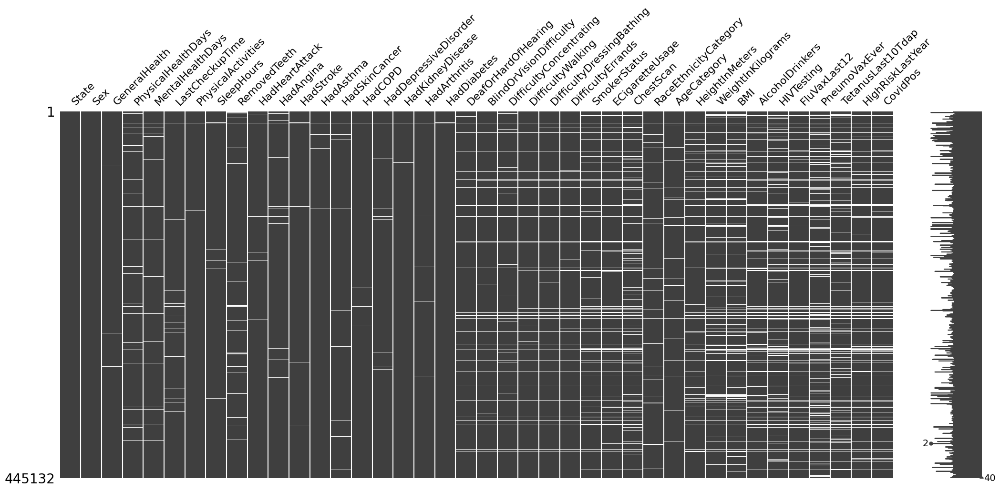

In [ ]:
msno.matrix(data)

<Axes: >

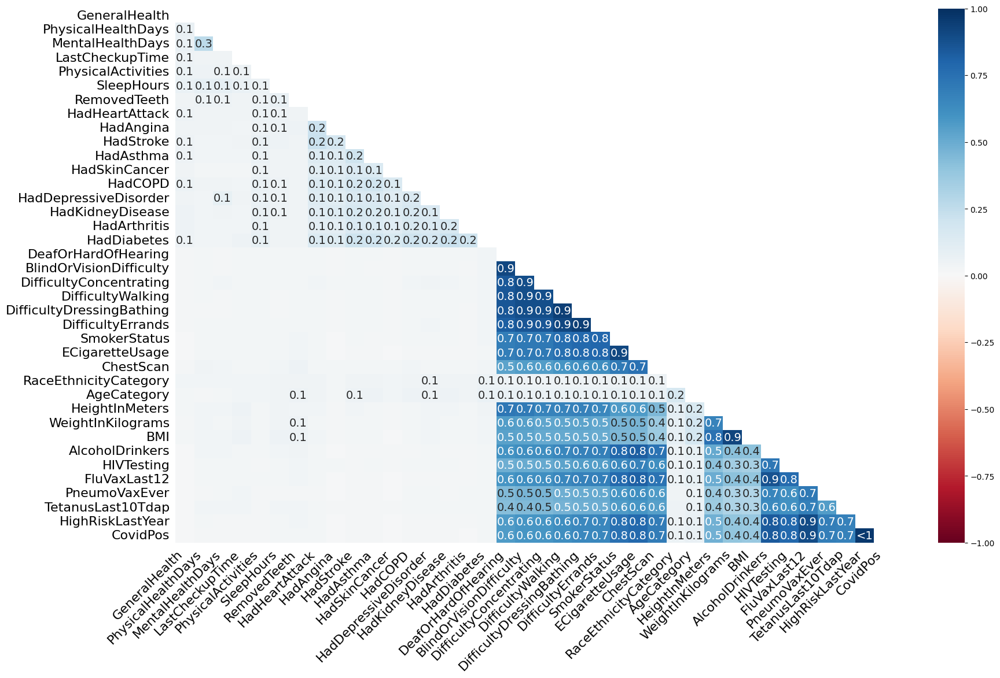

In [ ]:
msno.heatmap(data)

#**Cleaning the data**

In [ ]:
columns_to_check = ['DeafOrHardOfHearing', 'BlindOrVisionDifficulty', 'DifficultyConcentrating', 'DifficultyWalking', 'DifficultyDressingBathing', 'DifficultyErrands']
data = data.dropna(how='all', subset=columns_to_check)

In [ ]:
columns_to_check = ['SmokerStatus', 'ECigaretteUsage', 'ChestScan']
data = data.dropna(how='all', subset=columns_to_check)

In [ ]:
columns_to_check = ['HeightInMeters', 'WeightInKilograms', 'BMI']
data = data.dropna(how='all', subset=columns_to_check)

In [ ]:
columns_to_check = ['WeightInKilograms', 'BMI']
data = data.dropna(how='all', subset=columns_to_check)

In [ ]:
columns_to_check = ['HeightInMeters', 'BMI']
data = data.dropna(how='all', subset=columns_to_check)

In [ ]:
columns_to_check = ['AlcoholDrinkers', 'HIVTesting', 'FluVaxLast12', 'PneumoVaxEver', 'TetanusLast10Tdap', 'HighRiskLastYear', 'CovidPos']
data = data.dropna(how='all', subset=columns_to_check)

In [ ]:
columns_to_check = ['PneumoVaxEver', 'TetanusLast10Tdap']
data = data.dropna(how='all', subset=columns_to_check)

In [ ]:
columns_to_check = ['FluVaxLast12', 'PneumoVaxEver']
data = data.dropna(how='all', subset=columns_to_check)

In [ ]:
columns_to_check = ['HighRiskLastYear', 'CovidPos']
data = data.dropna(how='all', subset=columns_to_check)

<Axes: >

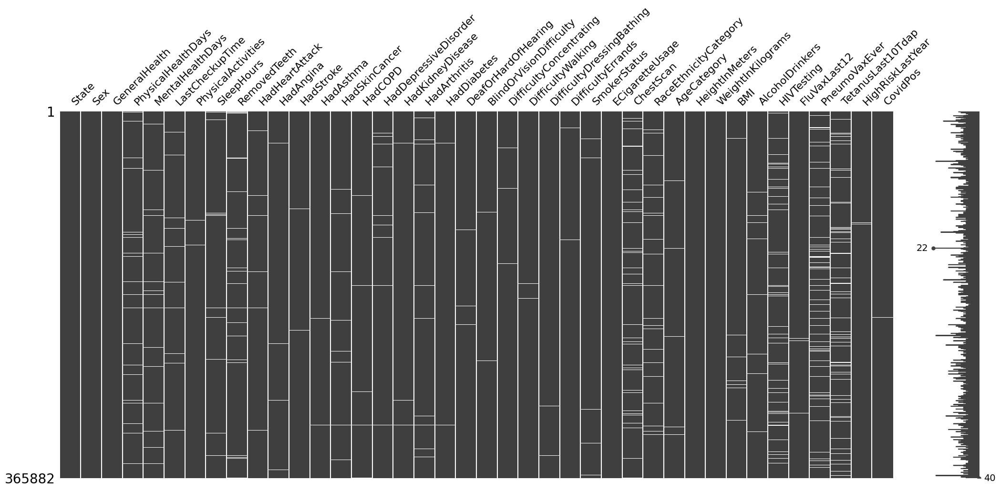

In [ ]:
msno.matrix(data)

In [ ]:
data.isnull().sum() / len(data) * 100

,0
State,0.000000
Sex,0.000000
GeneralHealth,0.220836
PhysicalHealthDays,2.171465
MentalHealthDays,1.775436
LastCheckupTime,1.564985
PhysicalActivities,0.184759
SleepHours,0.989937
RemovedTeeth,2.189777
HadHeartAttack,0.567943


##**Dropping unnecessary columns and filling missing values with mode for categorical data and median for numeric data**

In [ ]:
data = data.drop(columns=['RemovedTeeth', 'LastCheckupTime','HeightInMeters', 'WeightInKilograms', 'ECigaretteUsage', 'ChestScan',
                            'HIVTesting','FluVaxLast12','PneumoVaxEver','TetanusLast10Tdap','HighRiskLastYear','CovidPos'])


In [ ]:
data['PhysicalHealthDays'] = data['PhysicalHealthDays'].fillna(data['PhysicalHealthDays'].median())
data['MentalHealthDays'] = data['MentalHealthDays'].fillna(data['MentalHealthDays'].median())
data['SleepHours'] = data['SleepHours'].fillna(data['SleepHours'].median())
data['BMI'] = data['BMI'].fillna(data['BMI'].median())
data['GeneralHealth'] = data['GeneralHealth'].fillna(data['GeneralHealth'].mode()[0])
data['PhysicalActivities'] = data['PhysicalActivities'].fillna(data['PhysicalActivities'].mode()[0])
data['HadHeartAttack'] = data['HadHeartAttack'].fillna(data['HadHeartAttack'].mode()[0])
data['HadAngina'] = data['HadAngina'].fillna(data['HadAngina'].mode()[0])
data['HadStroke'] = data['HadStroke'].fillna(data['HadStroke'].mode()[0])
data['HadSkinCancer'] = data['HadSkinCancer'].fillna(data['HadSkinCancer'].mode()[0])
data['HadCOPD'] = data['HadCOPD'].fillna(data['HadCOPD'].mode()[0])
data['HadDepressiveDisorder'] = data['HadDepressiveDisorder'].fillna(data['HadDepressiveDisorder'].mode()[0])
data['HadKidneyDisease'] = data['HadKidneyDisease'].fillna(data['HadKidneyDisease'].mode()[0])
data['HadArthritis'] = data['HadArthritis'].fillna(data['HadArthritis'].mode()[0])
data['HadDiabetes'] = data['HadDiabetes'].fillna(data['HadDiabetes'].mode()[0])
data['HadAsthma'] = data['HadAsthma'].fillna(data['HadAsthma'].mode()[0])
data['DeafOrHardOfHearing'] = data['DeafOrHardOfHearing'].fillna(data['DeafOrHardOfHearing'].mode()[0])
data['BlindOrVisionDifficulty'] = data['BlindOrVisionDifficulty'].fillna(data['BlindOrVisionDifficulty'].mode()[0])
data['DifficultyConcentrating'] = data['DifficultyConcentrating'].fillna(data['DifficultyConcentrating'].mode()[0])
data['DifficultyWalking'] = data['DifficultyWalking'].fillna(data['DifficultyWalking'].mode()[0])
data['DifficultyDressingBathing'] = data['DifficultyDressingBathing'].fillna(data['DifficultyDressingBathing'].mode()[0])
data['DifficultyErrands'] = data['DifficultyErrands'].fillna(data['DifficultyErrands'].mode()[0])
data['SmokerStatus'] = data['SmokerStatus'].fillna(data['SmokerStatus'].mode()[0])
data['RaceEthnicityCategory'] = data['RaceEthnicityCategory'].fillna(data['RaceEthnicityCategory'].mode()[0])
data['AgeCategory'] = data['AgeCategory'].fillna(data['AgeCategory'].mode()[0])
data['AlcoholDrinkers'] = data['AlcoholDrinkers'].fillna(data['AlcoholDrinkers'].mode()[0])



In [ ]:
data.isnull().sum()

,0
State,0
Sex,0
GeneralHealth,0
PhysicalHealthDays,0
MentalHealthDays,0
PhysicalActivities,0
SleepHours,0
HadHeartAttack,0
HadAngina,0
HadStroke,0


In [ ]:
#data1=data.to_csv('heart_2022_cleaned.csv')

#**Data Analysis**

**Higlighting the most common diseases linked to heart disease**

In [ ]:
# Bar plot to show the most common diseases
health_conditions = ['HadHeartAttack', 'HadAngina', 'HadStroke', 'HadAsthma', 'HadSkinCancer', 'HadCOPD', 'HadDepressiveDisorder',
                     'HadKidneyDisease', 'HadArthritis', 'HadDiabetes']

# Count the number of 'Yes' values for each health condition
health_condition_counts = data[health_conditions].apply(lambda x: (x == 'Yes').sum())

# Convert the counts to a DataFrame for easier plotting
health_condition_df = health_condition_counts.reset_index()
health_condition_df.columns = ['Health Condition', 'Count']
health_condition_df = health_condition_df.sort_values(by='Count', ascending=True)

fig = px.bar(health_condition_df, x='Health Condition', y='Count', color='Count', title='Most Common Health Conditions Reported',
             labels={'Count': 'Count', 'Health Condition': 'Health Condition'})
fig.update_layout(xaxis_tickangle=-45)  # Rotate x-axis labels
fig.show()

The bar plot shows the most common diseases based on the counts of "Yes" responses for each health condition. We can tell that the most common disease is Arthritis suggesting that a significant portion of the population was reported to have arthritis while the least prevelant disease was Kidney disease. This could mean that arthritis is a widespread issue that needs more attention to figure out its causes or risk factors. Furthermore, the plot also helps identify health conditions that tend to appear together. For example, conditions like Depressive Disorder and Arthritis have relatively high counts, which means that there could be an association between these diseases which is something to investigate.



##**Investigating different factors that could be associated with Arthritis**

**1. Smoker Status**

In [ ]:
# Bar plot to see relationship between smoker status and had arthritis
fig = px.histogram(data, x='HadArthritis', color='SmokerStatus', barmode='group', title='Arthritis Incidence by Smoking Status',
                   labels={'HadArthritis': 'Had Arthritis', 'count': 'Count', 'SmokerStatus': 'Smoking Status'})
fig.show()


The bar plot compares the smoker status with the occurence of arthritis. Looking at the number of smokers versus the number of non-smokers, it's clear that smoking does not have an impact on the risk of developing arthritis since arthritis is more common in non-smokers. Non-smokers also clearly dominate the "No" category which indicates a lower risk of arthritis in this group. This suggests that smoking isn't a major contributor of arthritis and other factors like age, BMI, or physical activity, might play a bigger role for non-smokers with arthritis.




**2. Physical Activities**

In [ ]:
# Bar plot to see relationship between physical activities and arthritis
fig = px.histogram(data, x='HadArthritis', color='PhysicalActivities', barmode='group', title='Arthritis Incidence by Physical Activities',
                   labels={'HadArthritis': 'Had Arthritis', 'count': 'Count', 'Physical Activities': 'Physical activities'})
fig.show()


The bar plot compares the incidence of arthritis with physical activity levels, showing whether being active affects the chances of having arthritis or not. We see that many people with arthritis are also physically active, which suggests that other factors may be more important in causing arthritis. Since active people still report having arthritis, we can conclude that just being active is not enough to prevent arthritis.

**3. Age Category**

In [ ]:
# Bar plot to see relationship age category and had arthritis
fig = px.histogram(data, x='AgeCategory', color='HadArthritis', barmode='group',title='Arthritis by Age Category',
                   labels={'AgeCategory': 'Age Category', 'count': 'Count', 'HadArthritis': 'Arthritis'})
fig.show()


The bar plot shows the relationship between age category and the incidence of arthritis. We can see that arthritis is most common in people aged 65 to 69, followed by those in the 70-74 , 80 and older, 60 to 64 and 75-79 age categories. This shows that arthritis becomes more common as people get older, which is consistent with what we know—arthritis, especially osteoarthritis, is more common in older people because of joint wear and tear over time. This indicates a strong age-related trend in development of arthritis. Since older people are more likely to have arthritis, its important to detect or  prevent it early in aging populations. We can therefore conclude that age does in fact have a high association with arthritis incideneces.

**4. BMI**

In [ ]:
# Distribution of BMI depending on Arthritis
fig = px.box(data, x='HadArthritis', y='BMI', title='BMI Distribution by Arthritis',labels={'AgeCategory': 'Age Category', 'BMI': 'Body Mass Index'})
fig.show()

The box plot compares Body Mass Index (BMI) for people with and without arthritis. We can see that the median BMI is higher for people with arthritis, which suggests that those with arthritis may have a higher BMI. Since being overweight is a known risk factor for arthritis, this points to a possible link between higher BMI and arthritis. The range of BMI in the arthritis group is wider, meaning there’s more variation in BMI here, which could be due to factors like different stages of arthritis, treatments, or other health issues. Outliers with very high BMI in the arthritis group might have a higher chance of developing arthritis, since extra weight can put stress on joints. However, outliers with high BMI in the no-arthritis group don't have arthritis, which suggests that other factors other than BMI affect joint health. Overall, we can say that a higher BMI may increase the risk of getting arthritis, and managing weight could help with arthritis prevention. However, since the BMI differences aren't huge between the two groups, it suggests that other factors might also play a big role in developing arthritis.

**5. Gender**

In [ ]:
# Bar plot to see relationship between gender and had arthritis
fig = px.histogram(data, x='HadArthritis', color='Sex', barmode='group', title='Arthritis Incidence by Gender',
                   labels={'Hadarthritis': 'Had arthritis', 'count': 'Count', 'Sex': 'Gender'})
fig.show()


The bar plot shows the relationship between gender and the likelihood of having arthritis. We can see that women are more likely to have arthritis than men. We can conclude that women have a higher risk of developing arthritis, while men have a lower risk. Since the bars aren't very different, it suggests that while there is some link between gender and arthritis, it's not a strong one. This means gender may not be a major factor in getting arthritis. Because arthritis is more common in women, it could be helpful to focus education and early detection efforts on women to reduce the number of cases. This finding is in line with medical research, which shows that women, especially older women, tend to have higher rates of arthritis.

In [ ]:
fig = px.histogram(data, x='AgeCategory', color='HadArthritis', facet_col='Sex', barmode='stack',title='Arthritis by Age Category and Gender',
                   labels={'AgeCategory': 'Age Category', 'HadArthritis': 'Arthritis', 'count': 'Count', 'Sex': 'Gender'})
fig.show()


The stacked bar chart shows how arthritis is distributed by gender and age. It breaks down the data to show people that had arthritis and those that didn't in different age groups. We can see that women in older age groups have higher rates of arthritis compared to men. This matches up with what medical research shows, which is that arthritis is more common in older women.

**6. Other Conditions**

In [ ]:
# Bar plot to see relationship between depressive disorder and arthritis
fig = px.histogram(data, x='HadArthritis', color='HadDepressiveDisorder', barmode='group', title='Arthritis Incidence by Depression incidence',
                   labels={'HadArthritis': ' Had Arthritis', 'count': 'Count', 'HadDrpressiveDisorder': 'Depressive Disorder'})
fig.show()


The bar plot shows the relationship between arthritis and having a depressive disorder. We see that many people with arthritis don't have depression, but there are a number of people with both depression and arthritis. This matches research that shows that chronic conditions like arthritis can contribute to or increase depressive sysmptoms due to pain. However, since many people without arthritis have depression, it suggests that depression happens independently and is not necessarily linked to arthritis.

##**Investigating difficulties linked to Arthritis**

In [ ]:
# Filter arthritis patients
arthritis_patients = data[data['HadArthritis'] == 'Yes']

# Define the columns of interest
difficulties = ['DeafOrHardOfHearing','BlindOrVisionDifficulty','DifficultyConcentrating','DifficultyWalking','DifficultyDressingBathing','DifficultyErrands']

# Calculate the prevalence of each difficulty
prevalence = [arthritis_patients[difficulty].value_counts(normalize=True).get('Yes', 0)
    for difficulty in difficulties]

# Create a DataFrame for the results
difficulty_df = pd.DataFrame({"Difficulty": difficulties,"Prevalence": prevalence}).sort_values(by="Prevalence", ascending=False)

# Plotting
fig = px.bar(difficulty_df,x="Prevalence",y="Difficulty",orientation='h',title="Prevalence of Difficulties Among Arthritis Patients",
    labels={"Prevalence": "Prevalence", "Difficulty": "Difficulty"})
fig.show()


This graph visualizes the most common difficulties among arthritis patients. It allows us to identify which difficulties are most associated with arthritis and might require more resources or interventions. From the graph, the most prevelant difficulty is difficulty in walking which highlights the physical impact of arthritis on its patients. Medical efforts could focus on mobility aids such as canes and walkers or physical therapy programs tailored to arthritis patients.

Difficulty concentrating ranked second highest in difficulties associated to arthritis which might point to a link between arthritis and mental health issues. Mental health challenges are often recognized in people dealing with chronic pain such as arthritis patients and difficulty concentrating is linked to these mental challenges. Offering psychological support to arthritis patients or proper pain management, may help improve their concentration.

Additonaly, deaf or hard of hearing ranked third in the most common difficulties associated with arthritis which points to a link between sensory issues and arthritis especially considering the age demographic that is often affected by arthritis. However, hearing loss or difficulty might not be directly caused by arthritis but may be linked to other age-related conditions, such as age-related hearing loss, which often coexists with arthritis in older populations making hearing loss a co-occuring difficulty.
  





